#   Text Image Enhancement Before OCR  

#### 1. Libraries and Setup

#### 2. Read The Image and Testing OCR 

#### 3. Preprocessing Images for OCR
- ##### 3.1 Grayscale Conversion 
- ##### 3.2 Inverted Images 
- ##### 3.3 Thresholding
- ##### 3.4 Morphological Operations
- ##### 3.5 Noise Removal 
- ##### 3.6 Rotation / Deskewing




    

-------------------------------

## 1. Libraries and Setup
#### . OpenCV 
#### . Numpuy 
#### . Matplotlib
#### . pytesseract
#### . PIL

In [1]:
import cv2
from matplotlib import pyplot as plt
import pytesseract
from PIL import Image
import numpy as np

pytesseract.pytesseract.tesseract_cmd =r'C:\Program Files\Tesseract-OCR\tesseract'

__________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________

## 2. Read The Image and Testing OCR 



####  Function to display the Image with its actual Size

In [2]:
def display(im_path, title = None):
    dpi = 120


    height, width  = im_path.shape[:2]
    

    figsize = width / float(dpi), height / float(dpi)


    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])


    ax.axis('off')

    if title:
        ax.set_title(title)

    ax.imshow(im_path, cmap='gray')

    plt.show()

####  Function to plot multiple images

In [3]:


def plot_image(images, captions=None, cmap=None):
    num_images = len(images)
    
    # Calculate the width of the figure based on the number of images
    fig_width = 10 * num_images

    f, axes = plt.subplots(1, num_images, sharey=True)
    f.set_figwidth(fig_width)
    f.set_figheight(10)  # Set the height of the figure

    for ax, image, caption in zip(axes, images, captions):
        ax.imshow(image, cmap)
        ax.set_title(caption)
        ax.axis('off')  # Turn off axis labels

    plt.tight_layout()
    plt.show()



#### Funcution to use OCR

In [4]:
def OCR(img):

   text=pytesseract.image_to_string(img)
   print(text)


#### Function to read and display image

In [40]:
def read_image(image_path, Title = None):
    im_data = cv2.imread(image_path)
    display(im_data,title = Title)
    return im_data

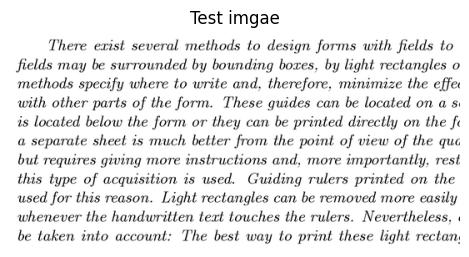

There exist several methods to design forms with fields to

fields may be surrounded by bounding boxes, by light rectangles o
‘methods specify where to write and, therefore, minimize the effe
with other parts of the form. These guides can be located on a s
is located below the form or they can be printed directly on the f
a separate sheet is much better from the point of view of the que
but requires giving more instructions and, more importantly, rest
this type of acquisition is used. Guiding rulers printed on the

used for this reason. Light rectangles can be removed more easily
whenever the handwritten teat touches the rulers. Nevertheless,
be taken into account: The best way to print these light rectan:



In [6]:
im_data = read_image("images/2.png", "Test imgae")
OCR(im_data)

__________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________

# 3- Preprocessing Images for OCR
#### 3.1 Grayscale Conversion 
#### 3.2 Inverted Images 
#### 3.3 Thresholding
#### 3.4 Morphological Operations
#### 3.5 Noise Removal 
#### 3.6 Rotation / Deskewing


 



## 3.1 Grayscale Conversion 

In [7]:
def grayscale(image):
   
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

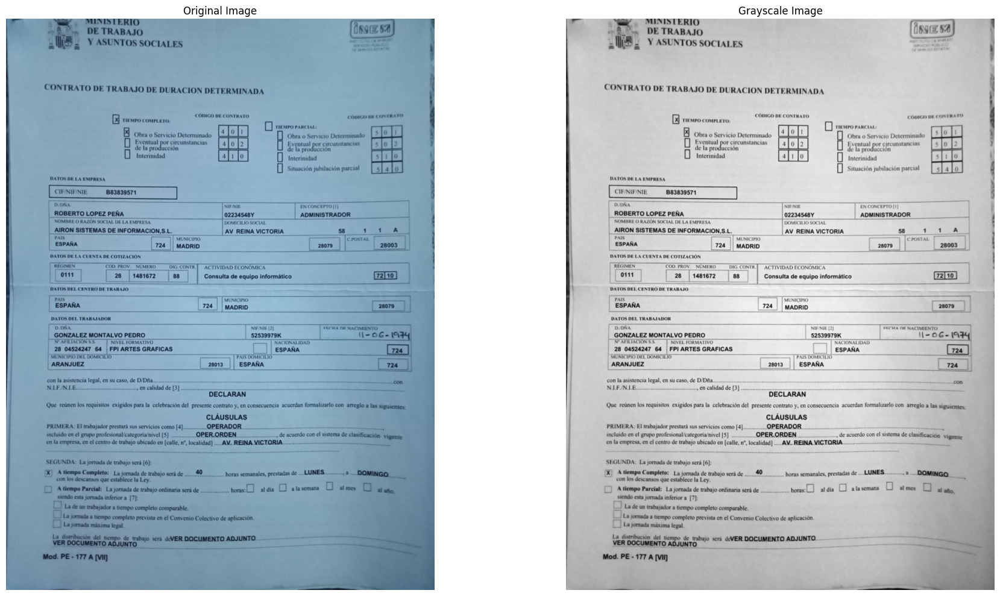

In [8]:
img="images/12.jpg"
im_data = cv2.imread(img)
gray_im=grayscale(im_data)

plot_image([im_data, gray_im], cmap='gray', captions = ["Original Image", "Grayscale Image"])



## 3.2 Inverted Images 

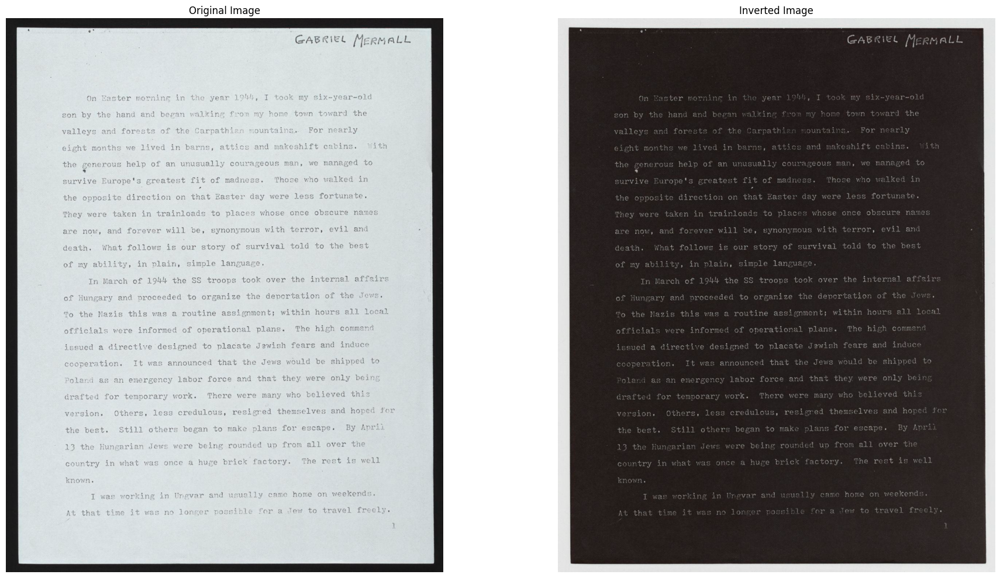

In [9]:
img="images/page_01.jpg"
im_data = cv2.imread(img)

inverted_image = cv2.bitwise_not(im_data)
plot_image([im_data, inverted_image], cmap='gray', captions = ["Original Image", "Inverted Image"])

__________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________________

## 3.3 Thresholding

- #### 3.3.1  Simple Thresholding

- #### 3.3.2 Adaptive thresholding

 ### 3.3.1 Simple Thresholding

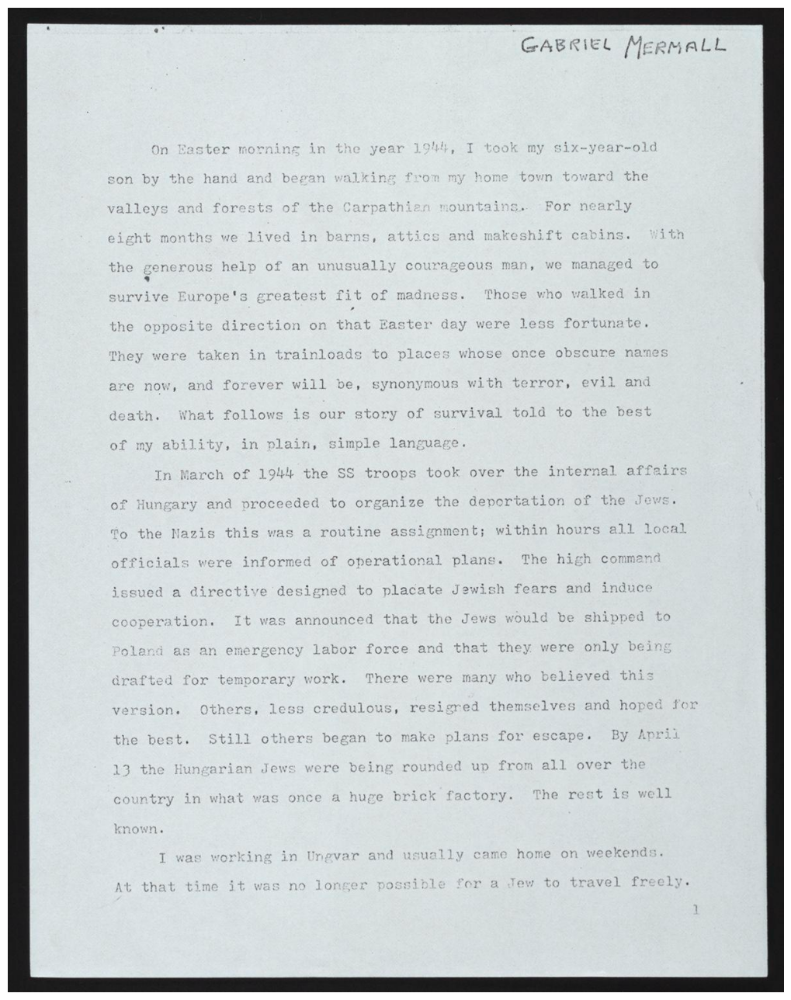

In [11]:
img="images/page_01.jpg"
im_data = cv2.imread(img)
display(im_data)

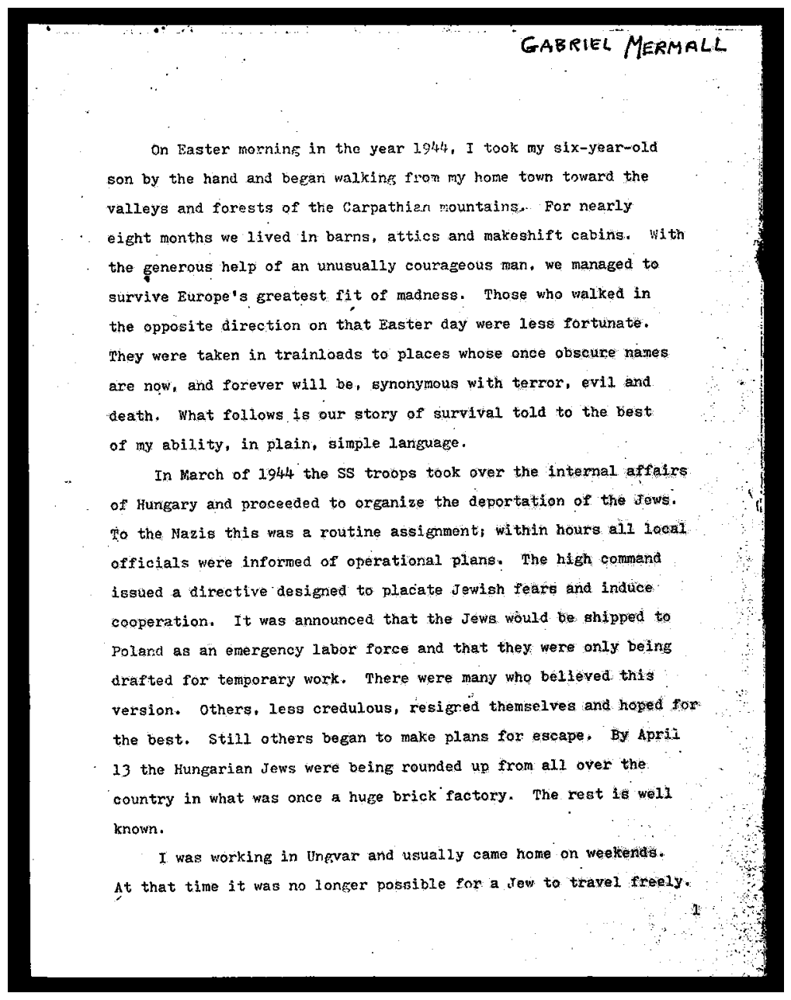

In [12]:
gray_image=grayscale(im_data)
thresh, Simple_thresh = cv2.threshold(gray_image, 210, 230, cv2.THRESH_BINARY)
display(Simple_thresh)

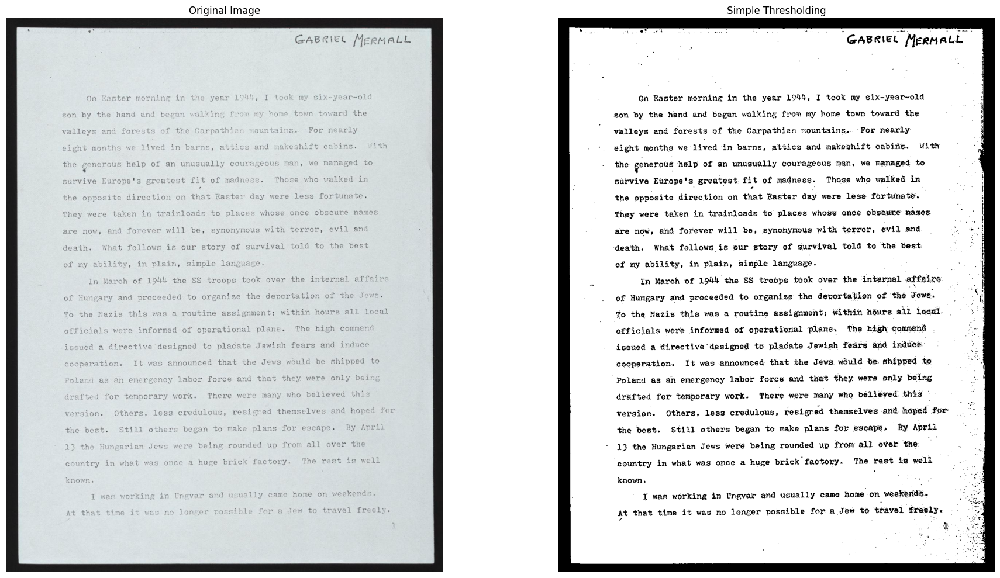

In [13]:
plot_image([im_data, Simple_thresh], cmap='gray', captions = ["Original Image", "Simple Thresholding"])


In [55]:
OCR(im_data)
print("-------------------------------------------")
OCR(Simple_thresh)


-------------------------------------------
NDIVIDUAL DE TRABAJO a TE

10 I y.
CONTRAT® "| NFERIOR A UN ANO 2015 RMINO FL

sages a vuabor, VILMA LORENA PARADA SIERRA, mayor de educa
cbs cena

bri aaore al pig de st firma, quien abr ¥ vecing
rl Nay cama aparece a . 4 como REPRESENTANTE toa

re COTA ARTE CONTEMPORANEO BAC, socicdad domuitidh en ANTE LEGAL
coal ees 47-93 y quien para efectos del presente: contrate on Rae, Me
TE ADOR 1 Ts PIKE ¥ PO! ta otra LUIS EDUARDO RARRERO CORDOBA identiicas sort
EMP! fama, donvaliado en Bogola - Cundinamarca y ubicads en la Cr § ra cr
° “ $470

v8 aT gcesne se llamara cl TRABAJADOR, so ha celebrado el presecte com:
soars GD 9, regido adomas por Tas siguientes clausulas: te contrat

e70. El. EMPLEADOR contrata los servicios personales del TRABAIAI é

PRIMERS ae or al servicio del EMPLEADOR toda su capacidad normal de abate von a
‘3s ‘unciones propias del oficio como DOMICILIARIO ¥ MENSAJERO y en las laberes
lementarias del mismo, de conformidad con l

### 3.3.2 Adaptive thresholding

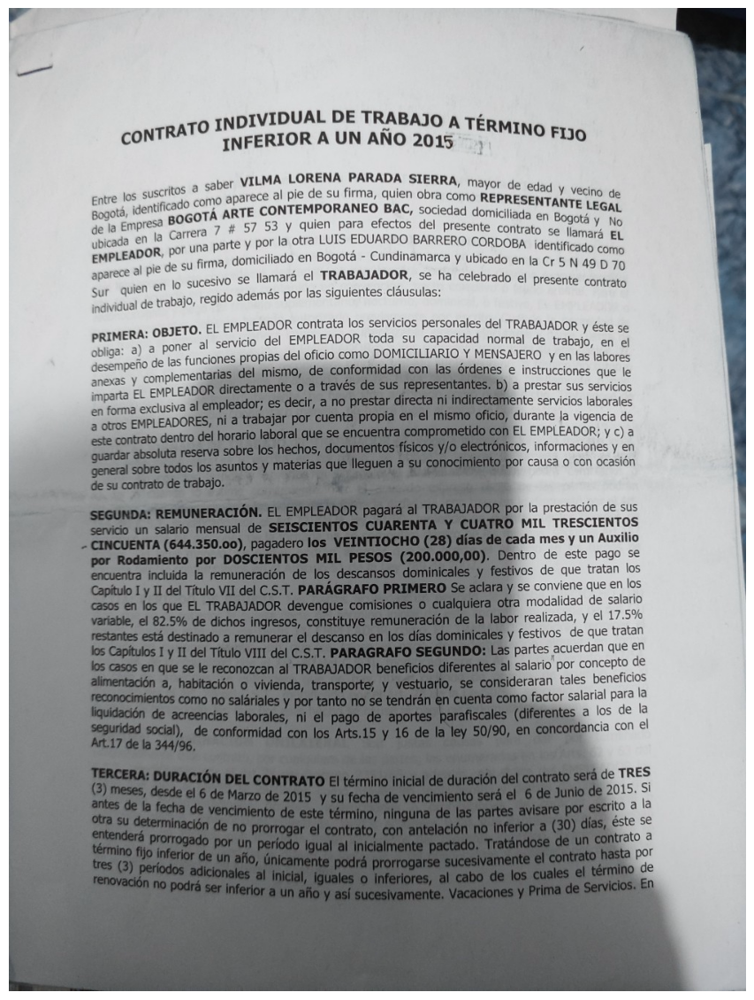

In [16]:
img="images/0.jpg"
im_data = cv2.imread(img)
display(im_data)


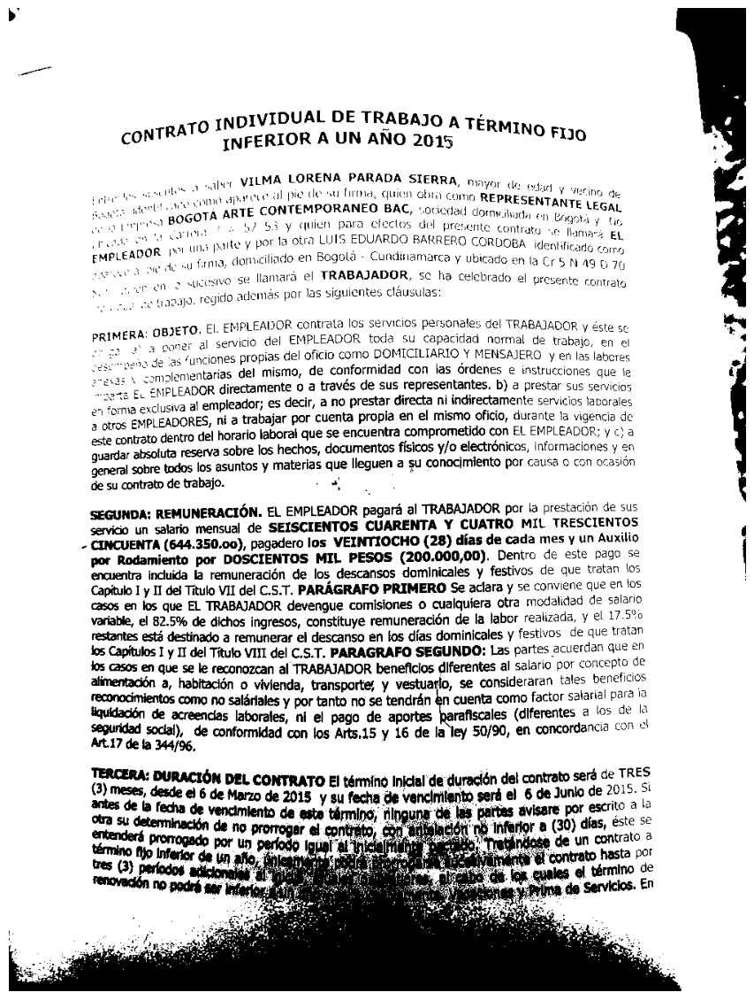

In [17]:
gray_image=grayscale(im_data)
thresh, Simple_thresh = cv2.threshold(gray_image, 101,255, cv2.THRESH_BINARY)
display(Simple_thresh)

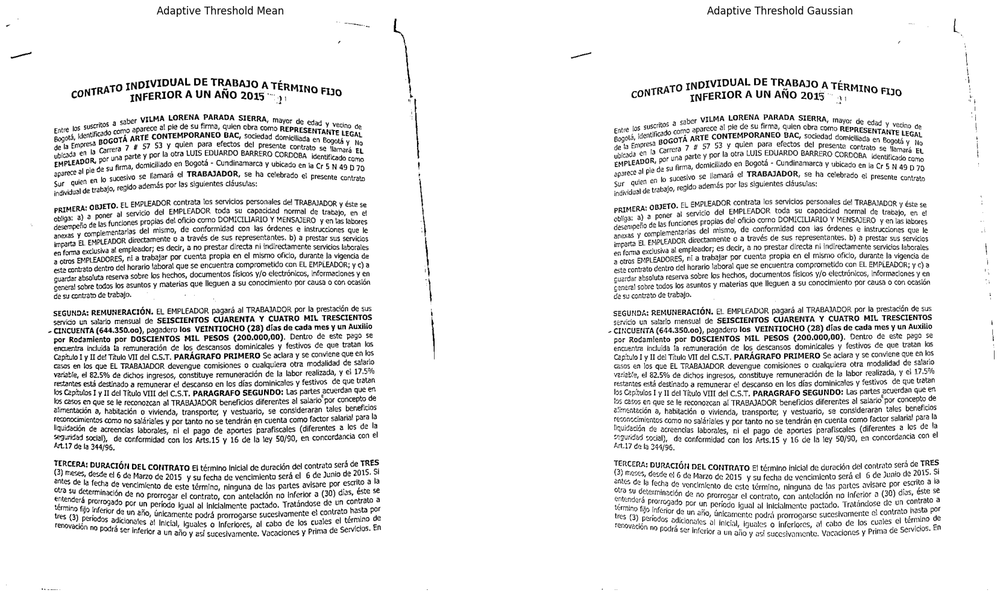

In [18]:
adaptive_threshold_mean = cv2.adaptiveThreshold(gray_image,255,cv2.ADAPTIVE_THRESH_MEAN_C,\
            cv2.THRESH_BINARY,11,20)
adaptive_threshold_gaussian = cv2.adaptiveThreshold(gray_image,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv2.THRESH_BINARY,11,20)

plot_image([adaptive_threshold_mean, adaptive_threshold_gaussian], cmap='gray', captions = ["Adaptive Threshold Mean", "Adaptive Threshold Gaussian"])

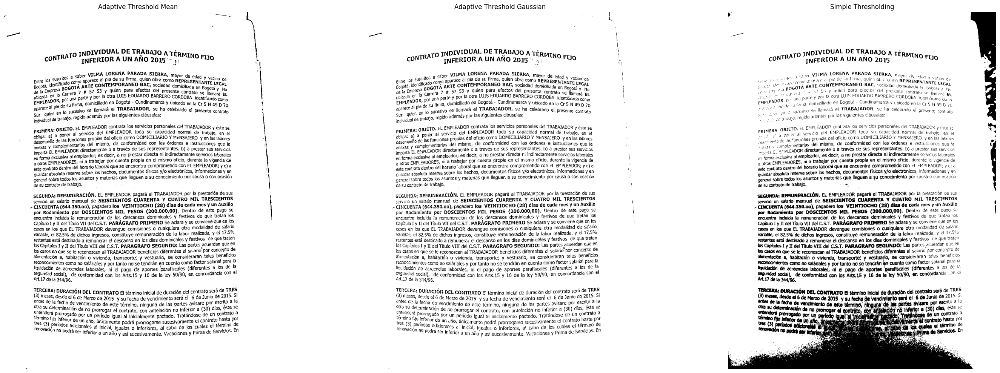

In [19]:
plot_image([adaptive_threshold_mean, adaptive_threshold_gaussian,Simple_thresh], cmap='gray', captions = ["Adaptive Threshold Mean", "Adaptive Threshold Gaussian","Simple Thresholding"])

---------------------

## 3.4 Morphological Operations

#### function for erode 

In [20]:
def thin_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

#### function for dilateion

In [21]:
def thick_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

In [22]:
img="images/157.png"
im_data = cv2.imread(img)

gray_image=grayscale(im_data)

adaptive_threshold_gaussian = cv2.adaptiveThreshold(gray_image,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv2.THRESH_BINARY,11,30)



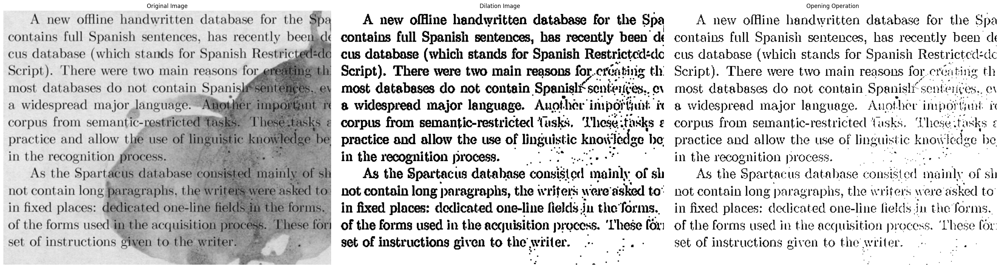

In [24]:
dilate=thick_font(adaptive_threshold_gaussian)
erode= thin_font(dilate)

plot_image([im_data,dilate, erode], cmap='gray', captions = ["Original Image", "Dilation Image","Opening Operation"])


In [25]:
OCR(im_data)
print("--------------------------------------------------------""\n")
OCR(erode)


A new offline handwritten database for the Spa
contains full Spanish sentences, has recently been de
cus database (which stands for Spanish Restric:
Script). There were two main reasons fore
most databases do not contain Spanis
a widespread major anguage
corpus from semantic-
practice and allow the
in the recognition

not contain long:
in fixed places:
of the forms

--------------------------------------------------------

A new offline handwritten database for the Spa
contains full Spanish sentences, has recently been dk
cus database (which stands for Spanish Restrictcd=dc
Script). There were two main reasons for créating th
most databases do not contain Spanisti* ‘senlicnices mo
a widespread major language. Auother ipor
corpus from semantic-restricted 4 These tasks ¢
practice and allow the use of linguistic knowledge he
in the recognition process. ° .

As the Spartacus database consisied nainly of sh
not contain long paragraphs, the writers were asked to
in fixed places: dedicated on

--------------------


## 3.5 Noise Removal
- #### 3.5.1 gaussian noise
- #### 3.5.2 salte and pepper noise
- #### 3.5.3 remove noise using Contours

### 3.5.1 gaussian noise

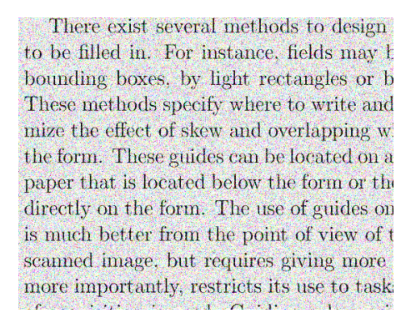

In [42]:
img="images/gaussian_noise.png"
im_data = cv2.imread(img)
display(im_data)

OCR(im_data)

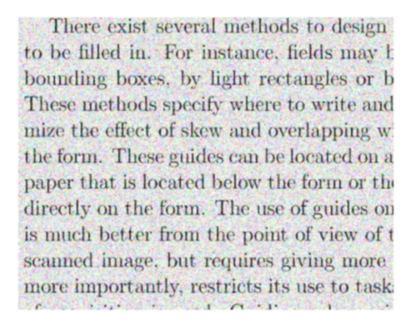

In [47]:
def remove_gaussian_noise(image,kernal):  
    denoised_image = cv2.GaussianBlur(image, (kernal, kernal), 0)  
    return denoised_image

denoised_image = remove_gaussian_noise(im_data,3)  
display(denoised_image)

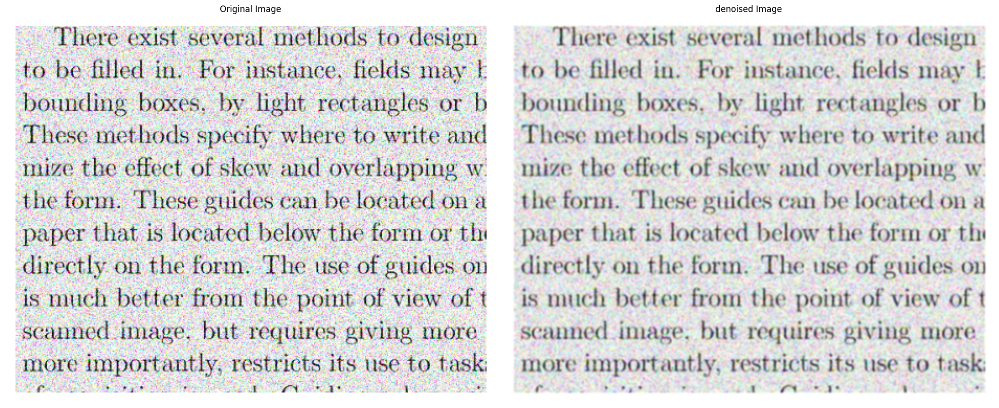


--------------------------------------

There exist several methods to design
to be filled in. For instance, fields may £
bounding boxes, by light rectangles or b
These methods specify where to write and
mize the effect of skew and overlapping w
the form. These guides can be located on a
paper that is located below the form or thi
directly on the form. The use of guides on
is much better from the point of view of t
scanned image. but requires giving more
more importantly, restricts its use to task

noe ’



In [29]:
plot_image([im_data, denoised_image], cmap='gray', captions = ["Original Image", "denoised Image"])

OCR(im_data)

print("--------------------------------------""\n")

OCR(denoised_image)

### 3.5.2 Salt and Papper noise

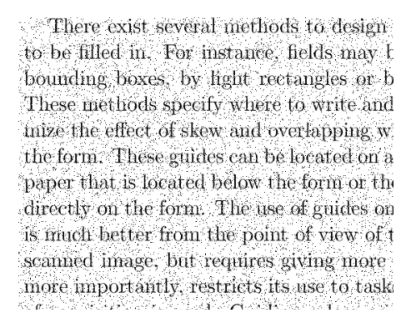

In [30]:

img="images/SALT_PAPPER_N.png"

im_data = cv2.imread(img)

display(im_data)

OCR(im_data)

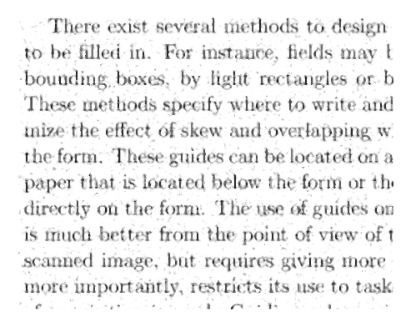

In [31]:
def remove_salt_and_pepper_noise(image):
    
    denoised_image = cv2.medianBlur(image, 3)  

    return denoised_image

denoised_image=remove_salt_and_pepper_noise(im_data)
display(denoised_image)


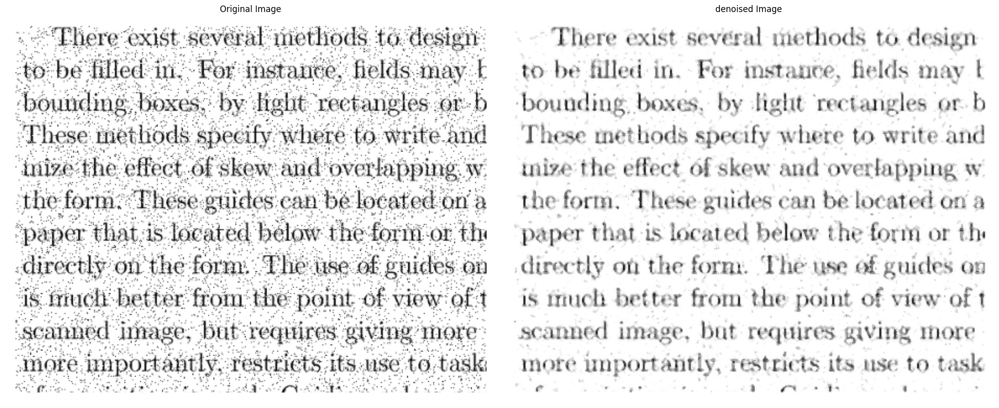


--------------------------------------

There exist several methods to. design
to be filled in. For instance, fields may |
‘bounding, boxes, by light ‘rectangles orb
These methods specify where to write and
tive the effect of skew and overlapping w
the form. These guides can be located on a
paper that is located below the form or th:
directly on the form. ‘The use of guides on
is much better from the point of view of t
scanned image, but requires giving more
more importantly, restricts its use to task

POA '



In [32]:
plot_image([im_data, denoised_image], cmap='gray', captions = ["Original Image", "denoised Image"])

OCR(im_data)

print("--------------------------------------""\n")

OCR(denoised_image)

### 3.5.3 remove noise using Contours

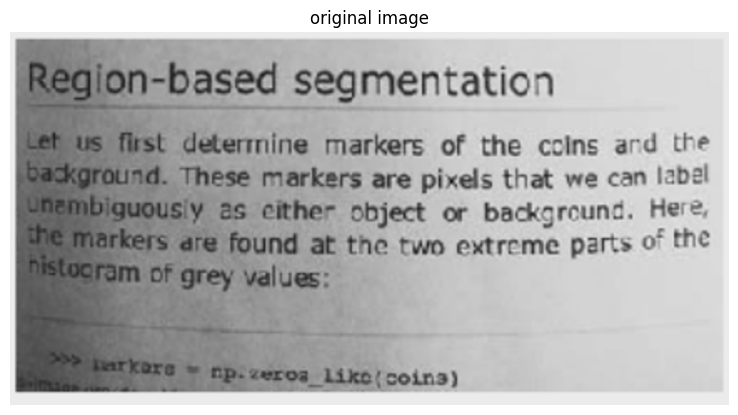

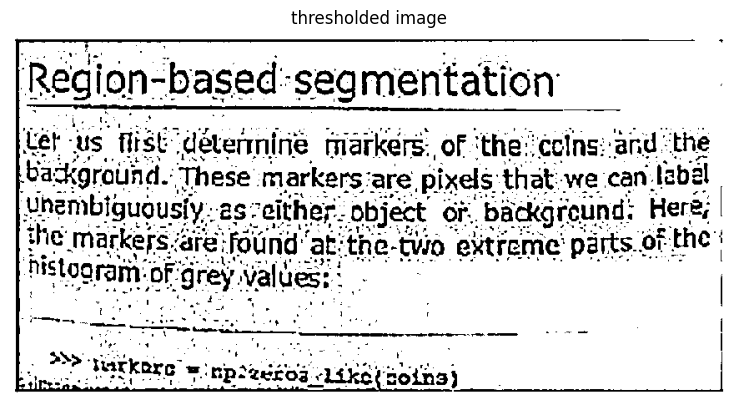

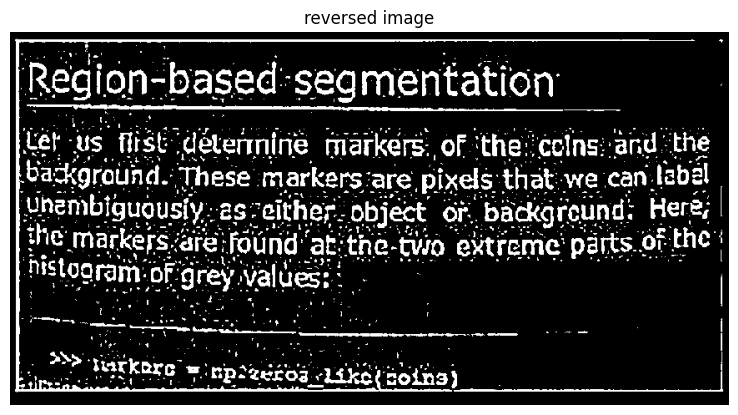

contours.shape: 1412


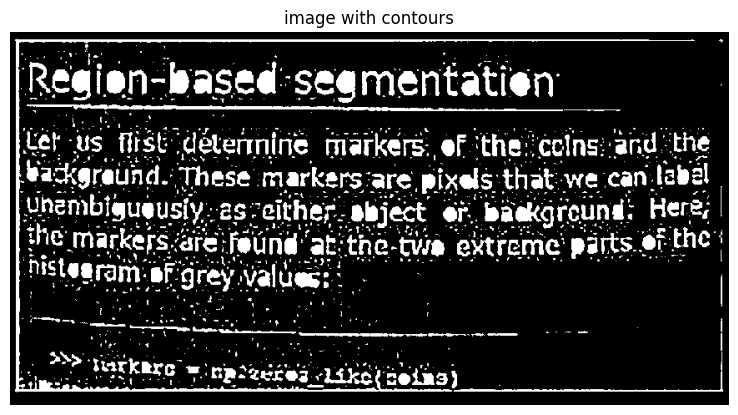

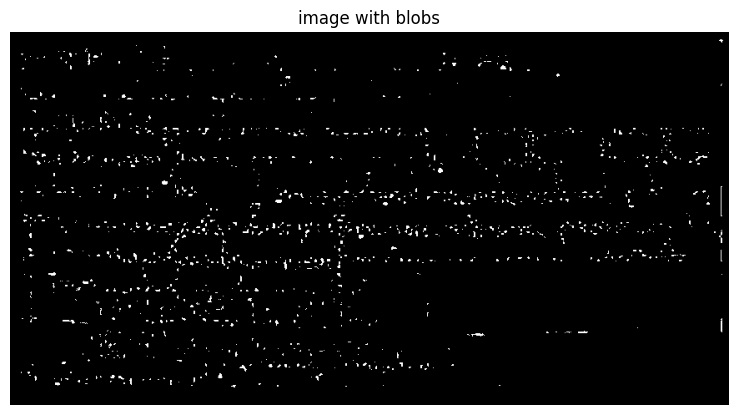

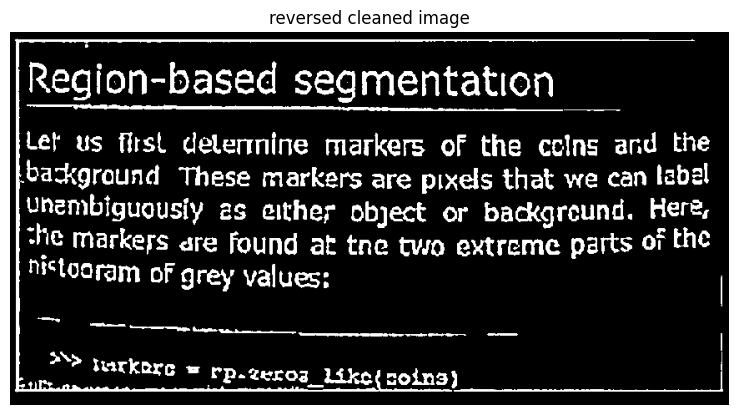

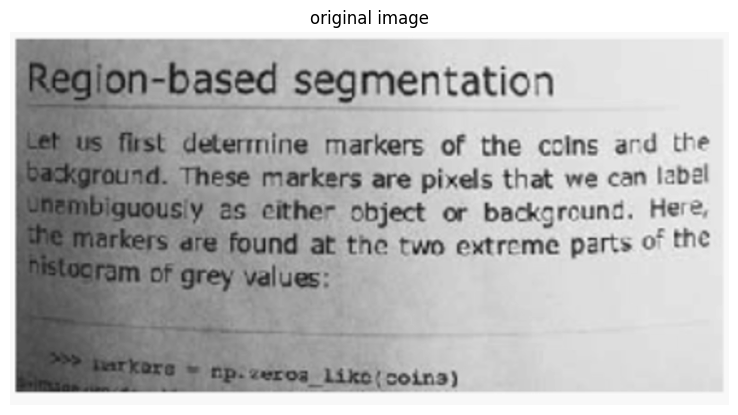

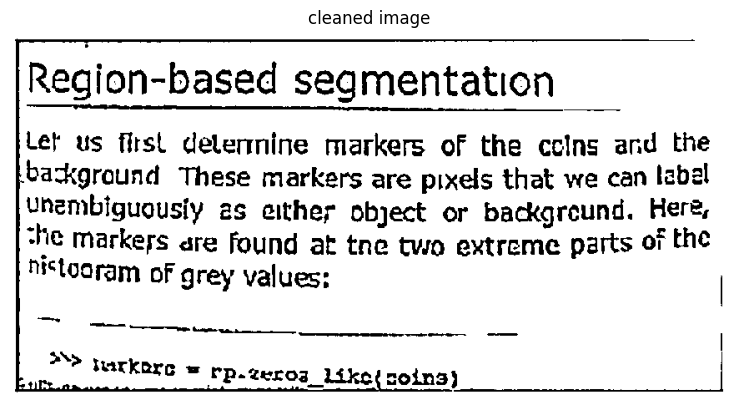

line markers of the coins ard the

rs are pixels that we can label
Object or background. Here,
the two extreme parts of the

###############################

Region-based segmentation _

Let us first delenmine markers of the cclns and the
background These markers are pixels that we can labal
unembiguously as either object or backgreund. Here,
she markers are found at tne two extreme parts of the
Mstooram of grey values:

ee,

o> harkore = Pp.gerog like soins)




In [56]:
img="images/text_bicubic_y.png"

image = cv2.imread(img)
display(image,title = "original image")

grimage = grayscale(image)

# function to detect contours, draw contours, remove noise
def filteringwithcontours(img):
    # Here, i define white color
    SCALAR_WHITE = (255.0, 255.0, 255.0)

    # thresholding the image best value (3)
    adaptive_threshold_gaussian = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 3)
    display(adaptive_threshold_gaussian, title = "thresholded image")
    image_reverse = cv2.bitwise_not(adaptive_threshold_gaussian)
    display(image_reverse,title = "reversed image")

    # function to draw and show contours
    def drawAndShowContours(wd, ht, contours, strImgName):
        blank_image = np.zeros((ht, wd), np.uint8)
        cv2.drawContours(blank_image, contours, -1, SCALAR_WHITE, -1)
        display(blank_image,title = "image with contours")
        return blank_image

    ht = np.size(image_reverse, 0)
    wd = np.size(image_reverse, 1)
    
    contours, hierarchy = cv2.findContours(
        image_reverse, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    print('contours.shape: ' + str(len(contours)))
    drawAndShowContours(wd, ht, contours, 'imgContours')

    # class blob to save the contours information
    class Blob:
        currentContour = [[0, 0]]

        def Blob(self, _contour):
            self.currentContour = _contour
            self.currentBoundingRect = cv2.boundingRect(_contour)

    # function to draw and show blobs
    def drawAndShowBlobs(wd, ht, blobs, strImgName):
        blank_image = np.zeros((ht, wd, 3), np.uint8)
        contours = []
        for blob in blobs:
            contours.append(blob.currentContour)
        contours.pop(0)
        cv2.drawContours(blank_image, contours, -1, SCALAR_WHITE, -1)
        display(blank_image,title= "image with blobs")
        return blank_image

    blob = Blob()
    blobs = [blob]

    # area best value (20) till now
    area = 20

    for contour in contours:
        possiBlob = Blob()
        possiBlob.Blob(contour)
        contourArea = cv2.contourArea(contour)
        if (contourArea < area):
            blobs.append(possiBlob)

    dots = drawAndShowBlobs(wd, ht, blobs, 'Blobs')
    dots_ = cv2.cvtColor(dots, cv2.COLOR_BGR2GRAY)
    imgDiff = cv2.absdiff(dots_, image_reverse)
    display(imgDiff,title="reversed cleaned image")

    image_clean = cv2.bitwise_not(imgDiff)
    display(grayscale(image),title = "original image")
    display(image_clean,title="cleaned image")

    return image_clean


# Call the function to execute the code
image_clean = filteringwithcontours(grimage)

OCR(image)
print("###############################""\n")
OCR(image_clean)

## 3.6 Rotation / Deskewing

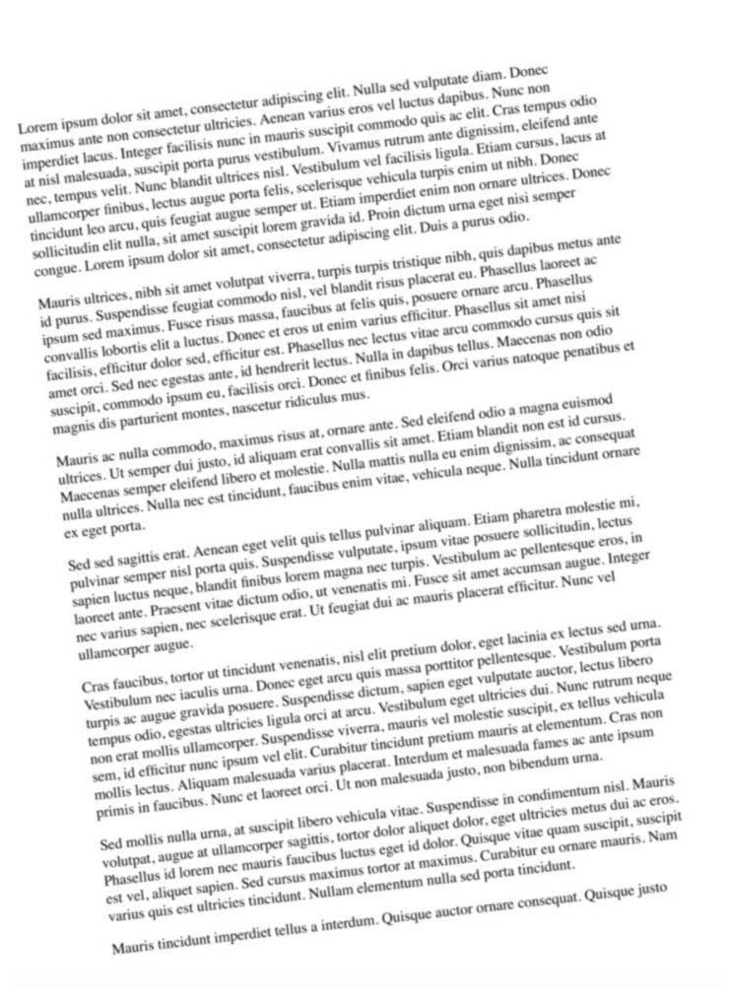

In [36]:
img="images/rotated.jpeg"
im_data = cv2.imread(img)
display(im_data)

 #### function to get the skewd angel 

In [37]:

def getSkewAngle(cvImage) -> float:

    newImage = cvImage.copy()
    gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (9, 9), 0)
    thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 5))
    dilate = cv2.dilate(thresh, kernel, iterations=5)

    contours, hierarchy = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key = cv2.contourArea, reverse = True)



    middleContour = contours[len(contours) // 2]
    angle = cv2.minAreaRect(middleContour)[-1]

    if angle > 45: 
        angle = -(90 - angle)
    return -1.0 * angle

#### function to rotaote the image 

In [38]:
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage

# Deskew image
def deskew(cvImage):
    angle = getSkewAngle(cvImage)
    return rotateImage(cvImage, -1.0 * angle)

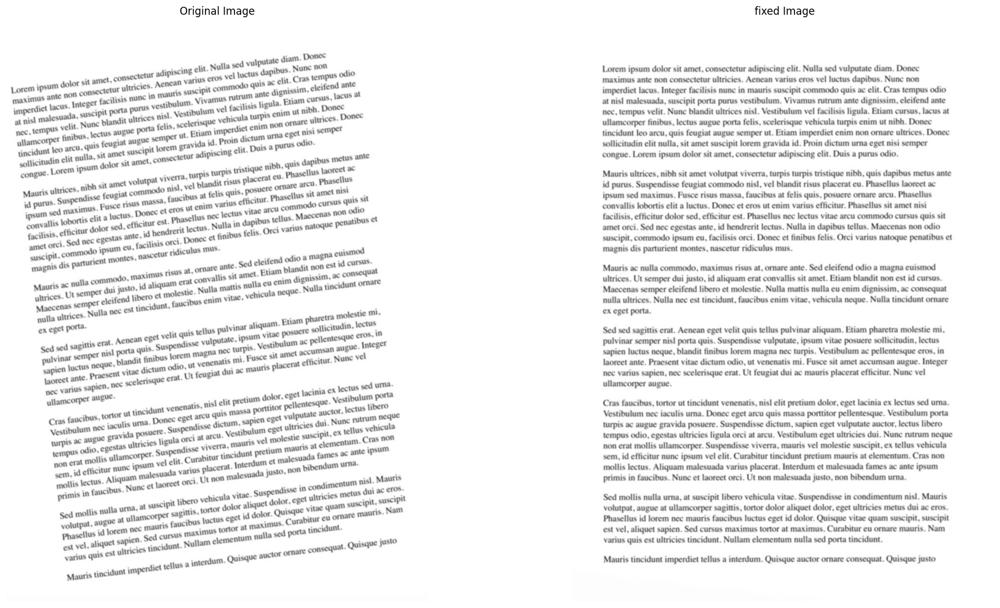

In [39]:
#fixed = deskew(im_data)
d=deskew(im_data)
plot_image([im_data, d], cmap='gray', captions = ["Original Image", " fixed Image"])